In [4]:
import numpy as np
import pandas as pd
import geopandas as gpd
import tgess
import os
from sklearn.preprocessing import StandardScaler
from datetime import datetime
from tqdm.auto import tqdm
from sklearn.model_selection import cross_validate, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, \
                            r2_score, mean_absolute_percentage_error
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import WhiteKernel, RBF, RationalQuadratic
from modAL.models import ActiveLearner
from tgess.src.data_science.plots import *
from tgess.src.data_science.experiment import *
import seaborn as sns
import matplotlib.pyplot as plt
from enum import Flag, IntFlag, auto

sns.set_theme()
sns.set_style("whitegrid")
tqdm.pandas()

In [5]:
from datetime import datetime, timedelta

# Inner Mongolia grasslands

In [2]:
filename = "../data/raw/AGB/IMAR_grasslandAGBsamplingplots"

In [7]:
gdf = gpd.read_file(filename)

In [8]:
gdf["Date"]=gdf["Date"].apply(lambda x: datetime.strptime(x, '%Y-%m-%d').date())
gdf["date_start"] = gdf["Date"].apply(lambda x: str(x - timedelta(days=30)))
gdf["date_end"] = gdf["Date"].apply(lambda x: str(x))
gdf

,Year,SPID,Long,Lat,DEM,AGB,Date,DOY,geometry,date_start,date_end
0,2013.0,178.0,111.217399,41.841417,1520.0,37.6,2013-08-05,217.0,POINT (111.21740 41.84142),2013-07-06,2013-08-05
1,2013.0,149.0,112.738834,42.680528,1105.0,25.6,2013-08-02,217.0,POINT (112.73883 42.68053),2013-07-03,2013-08-02
2,2013.0,220.0,109.422656,41.394393,1582.0,29.6,2013-08-08,225.0,POINT (109.42266 41.39439),2013-07-09,2013-08-08
3,2013.0,188.0,110.992610,42.327797,1168.0,30.4,2013-08-06,225.0,POINT (110.99261 42.32780),2013-07-07,2013-08-06
4,2013.0,30.0,113.857694,43.828553,1161.0,46.8,2013-07-31,217.0,POINT (113.85769 43.82855),2013-07-01,2013-07-31
5,2013.0,183.0,111.062783,42.040938,1254.0,54.0,2013-08-06,225.0,POINT (111.06278 42.04094),2013-07-07,2013-08-06
6,2013.0,214.0,109.740716,41.475922,1636.0,42.4,2013-08-08,225.0,POINT (109.74072 41.47592),2013-07-09,2013-08-08
7,2013.0,204.0,110.124626,41.978044,1368.0,39.2,2013-08-07,225.0,POINT (110.12463 41.97804),2013-07-08,2013-08-07
8,2013.0,80.0,116.066200,44.893391,896.0,79.2,2013-07-24,209.0,POINT (116.06620 44.89339),2013-06-24,2013-07-24
9,2013.0,35.0,113.422199,44.138099,1025.0,43.6,2013-07-31,217.0,POINT (113.42220 44.13810),2013-07-01,2013-07-31


## Download LANDSAT values

In [9]:
import ee

# Trigger the authentication flow.
ee.Authenticate()

# Initialize the library.
ee.Initialize()

Enter verification code: 4/1AX4XfWgFERsI3RjPqvN97gWetw5qFBIBFZOWx-WY8_mCTLtJzWokbUh75gw

Successfully saved authorization token.


In [44]:
for col in simulation_cols:
    print("- \'{}\'".format(col))

- 'CoastalAerosol'
- 'Blue'
- 'Green'
- 'Red'
- 'NIR'
- 'Cirrus'
- 'SWIR1'
- 'SWIR2'
- 'Pan'


In [18]:
simulation_cols = ['CoastalAerosol', 'Blue', 'Green', 'Red', 'NIR', 'Cirrus', \
                   'SWIR1', 'SWIR2', 'Pan']
band_cols = ["SR_B1", "SR_B2", "SR_B3", "SR_B4", "SR_B5", "SR_B6", "SR_B7"]

landsat_bands_to_simulation_cols = {"SR_B1":"CoastalAerosol", "SR_B2":'Blue', \
                                    "SR_B3":'Green', "SR_B4":'Red', "SR_B5":'NIR', \
                                    "SR_B6":'SWIR1', "SR_B7":'SWIR2'}
quality_col = "QA_PIXEL"

class QA_flag(IntFlag):
    dilated_cloud = 2**1
    cloud = 2**3
    cloud_shadow = 2**4
    snow = 2**5
    
def qa_flag_mask(x):
    return (QA_flag.dilated_cloud or QA_flag.cloud or QA_flag.cloud_shadow or QA_flag.snow) in QA_flag(x)

def create_reflectance_df(df, output_path, collection_name="LANDSAT/LC08/C02/T1_L2"):

    n_missing = 0
    for index, row in tqdm(df.iterrows(), total=len(df)):
        aoi = ee.Geometry.Point(lon=row["Long"], lat=row["Lat"])
        # Get all values within one month before or after
        collection = ee.ImageCollection(collection_name)\
                        .filterBounds(aoi)\
                        .filterDate(ee.Date(row["date_start"]), ee.Date(row["date_end"]))
                
        count = collection.size()
                       
        if count.getInfo()>0:
          
            # Retrieve properties as time series (list)
            zenith_angle = collection.aggregate_array("SUN_ELEVATION").getInfo()
            azimuth_angle = collection.aggregate_array("SUN_AZIMUTH").getInfo()
                       
            # Retrieve pixel values for region as time series (list of lists)
            
            values = collection.getRegion(geometry=aoi, scale=10)
            values = values.getInfo()
                        
            # Create dataframe
            values = pd.DataFrame(values)
            
            
            # First row is header
            values.columns = values.iloc[0]
            values = values[1:]
            
            values["index"] = index
            
            # Create columns for properties time series
            values["zenith_angle"] = np.repeat([90], repeats=len(zenith_angle)) - np.array(zenith_angle)
            values["azimuth_angle"] = azimuth_angle
            values["retrieval_datetime"] = pd.to_datetime(values["time"], unit='ms')
            values["in_situ_datetime"] = pd.to_datetime(row["Date"])
            
            # Filter by pixel quality
            mask = values["QA_PIXEL"].apply(qa_flag_mask)
            values = values[~mask]
                        
            # Select closest
            values["datetime_difference"] = (values["retrieval_datetime"] - values["in_situ_datetime"]).abs()
            values = values.sort_values(by=["datetime_difference"], ascending=True)
            
            # Append output to csv
            values = values.dropna()
        
            if len(values)>0:
                pd.DataFrame(values.iloc[0]).T.to_csv(output_path, mode="a", header=not os.path.exists(output_path))
            
        else:
            print("Missing data for row {}".format(index))
            n_missing +=1

        sleep(0.1)
        
    print(n_missing)
    return

In [11]:
output_path = "mongolia_landsat.csv"
# create_reflectance_df(gdf, output_path, collection_name="LANDSAT/LC08/C02/T1_L2")

In [12]:
out_df = pd.read_csv(output_path)
out_df.columns

Index(['Unnamed: 0', 'id', 'longitude', 'latitude', 'time', 'SR_B1', 'SR_B2',
       'SR_B3', 'SR_B4', 'SR_B5', 'SR_B7', 'SR_B6', 'SR_QA_AEROSOL', 'ST_B10',
       'ST_ATRAN', 'ST_CDIST', 'ST_DRAD', 'ST_EMIS', 'ST_EMSD', 'ST_QA',
       'ST_TRAD', 'ST_URAD', 'QA_PIXEL', 'QA_RADSAT', 'index', 'zenith_angle',
       'azimuth_angle', 'retrieval_datetime', 'in_situ_datetime',
       'datetime_difference'],
      dtype='object')

In [22]:
out_df = out_df.rename(columns=landsat_bands_to_simulation_cols)
out_df = out_df.rename(columns={"zenith_angle":"solar_zenith"})

In [63]:
in_situ_df = pd.DataFrame(gdf).join(out_df)
in_situ_df

,Year,SPID,Long,Lat,DEM,AGB,Date,DOY,geometry,date_start,...,ST_TRAD,ST_URAD,QA_PIXEL,QA_RADSAT,index,solar_zenith,azimuth_angle,retrieval_datetime,in_situ_datetime,datetime_difference
0,2013.0,178.0,111.217399,41.841417,1520.0,37.6,2013-08-05,217.0,POINT (111.21740 41.84142),2013-07-06,...,6228.0,2063.0,55052.0,0.0,0.0,26.075467,132.661606,2013-07-11 03:19:50.020,2013-08-05 00:00:00.000,24 days 20:40:09.980000
1,2013.0,149.0,112.738834,42.680528,1105.0,25.6,2013-08-02,217.0,POINT (112.73883 42.68053),2013-07-03,...,11518.0,2007.0,21824.0,0.0,1.0,28.189328,136.703829,2013-07-20 03:13:13.463,2013-08-02 00:00:00.000,12 days 20:46:46.537000
2,2013.0,220.0,109.422656,41.394393,1582.0,29.6,2013-08-08,225.0,POINT (109.42266 41.39439),2013-07-09,...,11339.0,1396.0,21824.0,0.0,2.0,29.997094,137.856185,2013-08-03 03:26:01.803,2013-08-08 00:00:00.000,4 days 20:33:58.197000
3,2013.0,188.0,110.992610,42.327797,1168.0,30.4,2013-08-06,225.0,POINT (110.99261 42.32780),2013-07-07,...,10707.0,2251.0,21824.0,0.0,3.0,26.075467,132.661606,2013-07-11 03:19:50.020,2013-08-06 00:00:00.000,25 days 20:40:09.980000
4,2013.0,30.0,113.857694,43.828553,1161.0,46.8,2013-07-31,217.0,POINT (113.85769 43.82855),2013-07-01,...,11521.0,1408.0,21824.0,0.0,4.0,29.837824,138.713502,2013-07-29 03:07:04.581,2013-07-31 00:00:00.000,1 days 20:52:55.419000
5,2013.0,183.0,111.062783,42.040938,1254.0,54.0,2013-08-06,225.0,POINT (111.06278 42.04094),2013-07-07,...,7627.0,2225.0,22280.0,0.0,5.0,26.075467,132.661606,2013-07-11 03:19:50.020,2013-08-06 00:00:00.000,25 days 20:40:09.980000
6,2013.0,214.0,109.740716,41.475922,1636.0,42.4,2013-08-08,225.0,POINT (109.74072 41.47592),2013-07-09,...,11120.0,1374.0,21824.0,0.0,6.0,29.997094,137.856185,2013-08-03 03:26:01.803,2013-08-08 00:00:00.000,4 days 20:33:58.197000
7,2013.0,204.0,110.124626,41.978044,1368.0,39.2,2013-08-07,225.0,POINT (110.12463 41.97804),2013-07-08,...,11030.0,1543.0,21824.0,0.0,7.0,29.997094,137.856185,2013-08-03 03:26:01.803,2013-08-07 00:00:00.000,3 days 20:33:58.197000
8,2013.0,80.0,116.066200,44.893391,896.0,79.2,2013-07-24,209.0,POINT (116.06620 44.89339),2013-06-24,...,5286.0,3086.0,55052.0,0.0,8.0,29.399111,139.470685,2013-07-22 03:00:27.618,2013-07-24 00:00:00.000,1 days 20:59:32.382000
9,2013.0,35.0,113.422199,44.138099,1025.0,43.6,2013-07-31,217.0,POINT (113.42220 44.13810),2013-07-01,...,11651.0,1771.0,21824.0,0.0,9.0,29.053927,139.117529,2013-07-20 03:12:49.580,2013-07-31 00:00:00.000,10 days 20:47:10.420000


In [66]:
in_situ_df.columns

Index(['Year', 'SPID', 'Long', 'Lat', 'DEM', 'AGB', 'Date', 'DOY', 'geometry',
       'date_start', 'date_end', 'Unnamed: 0', 'id', 'longitude', 'latitude',
       'time', 'CoastalAerosol', 'Blue', 'Green', 'Red', 'NIR', 'SWIR2',
       'SWIR1', 'SR_QA_AEROSOL', 'ST_B10', 'ST_ATRAN', 'ST_CDIST', 'ST_DRAD',
       'ST_EMIS', 'ST_EMSD', 'ST_QA', 'ST_TRAD', 'ST_URAD', 'QA_PIXEL',
       'QA_RADSAT', 'index', 'solar_zenith', 'azimuth_angle',
       'retrieval_datetime', 'in_situ_datetime', 'datetime_difference'],
      dtype='object')

In [67]:
in_situ_df[['CoastalAerosol', 'Blue', 'Green', 'Red', 'NIR', 'SWIR1', 'SWIR2']] = \
in_situ_df[['CoastalAerosol', 'Blue', 'Green', 'Red', 'NIR', 'SWIR1', 'SWIR2']] * 2.75e-05 - 0.2

In [71]:
feature_cols.append("AGB")

In [72]:
in_situ_df[feature_cols].dropna().to_csv("../data/processed/AGB/in_situ.csv")

In [70]:
in_situ_df[feature_cols].describe()

,CoastalAerosol,Blue,Green,Red,NIR,SWIR1,SWIR2,solar_zenith
count,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000
mean,0.265849,0.278209,0.306724,0.326798,0.422656,0.348201,0.279291,29.023024
std,0.368851,0.360715,0.323481,0.312319,0.257170,0.118555,0.092278,1.167903
min,0.012162,0.026023,0.050800,0.056355,0.128460,0.105718,0.075110,26.075467
25%,0.054540,0.069885,0.114573,0.130275,0.268352,0.273275,0.221988,28.527133
50%,0.072690,0.089328,0.149718,0.195532,0.308970,0.334792,0.273138,29.399111
75%,0.336223,0.342300,0.361990,0.372303,0.464620,0.413305,0.342740,29.837824
max,1.186523,1.195708,1.129158,1.127783,1.126518,0.702880,0.536202,30.888552


In [38]:
simulation_df = pd.read_csv("../data/processed/PROSAIL_LUT_Landsat8_100000_grasslands.csv")

In [39]:
simulation_df.columns

Index(['Unnamed: 0', 'n', 'cab', 'car', 'cbrown', 'cw', 'cm', 'lai', 'lidfa',
       'hspot', 'solar_zenith', 'observer_zenith', 'relative_azimuth', 'rsoil',
       'psoil', 'typelidf', 'alpha', 'CoastalAerosol', 'Blue', 'Green', 'Red',
       'NIR', 'Cirrus', 'SWIR1', 'SWIR2', 'Pan'],
      dtype='object')

In [40]:
simulation_df["AGB_estimate"] = simulation_df["lai"]*simulation_df["cm"]*10000
simulation_df.describe()

,Unnamed: 0,n,cab,car,cbrown,cw,cm,lai,lidfa,hspot,...,CoastalAerosol,Blue,Green,Red,NIR,Cirrus,SWIR1,SWIR2,Pan,AGB_estimate
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,...,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,49999.500000,1.700000,35.000000,7.000000,1.000000,0.015000,0.007500,4.000000,45.000000,0.075000,...,0.022852,0.025798,0.052640,0.030917,0.347981,0.241157,0.199981,0.085895,0.042135,299.936235
std,28867.657797,0.115471,11.547063,2.309413,0.577353,0.002887,0.001443,2.309413,23.094126,0.014434,...,0.013656,0.014276,0.026285,0.020364,0.130716,0.076007,0.060843,0.034136,0.021248,185.441786
min,0.000000,1.500002,15.000200,3.000040,0.000010,0.010000,0.005000,0.000040,5.000400,0.050000,...,0.000984,0.001484,0.004666,0.001879,0.038162,0.059100,0.044836,0.014022,0.003439,0.002505
25%,24999.750000,1.600001,25.000100,5.000020,0.500005,0.012500,0.006250,2.000020,25.000200,0.062500,...,0.015679,0.017786,0.034411,0.019144,0.241018,0.184903,0.156876,0.063804,0.027885,144.686495
50%,49999.500000,1.700000,35.000000,7.000000,1.000000,0.015000,0.007500,4.000000,45.000000,0.075000,...,0.021223,0.024077,0.048257,0.025965,0.356755,0.246656,0.204997,0.083074,0.038535,288.465238
75%,74999.250000,1.799999,44.999900,8.999980,1.499995,0.017500,0.008750,5.999980,64.999800,0.087500,...,0.025775,0.029923,0.066196,0.036364,0.447628,0.297838,0.243842,0.103249,0.052178,433.951121
max,99999.000000,1.899998,54.999800,10.999960,1.999990,0.020000,0.010000,7.999960,84.999600,0.100000,...,0.128067,0.132022,0.210704,0.180097,0.740193,0.487061,0.412420,0.286632,0.161745,795.842006


In [41]:
in_situ_df.describe()

,Year,SPID,Long,Lat,DEM,AGB,DOY,Unnamed: 0,longitude,latitude,...,ST_EMIS,ST_EMSD,ST_QA,ST_TRAD,ST_URAD,QA_PIXEL,QA_RADSAT,index,solar_zenith,azimuth_angle
count,46.0,46.000000,46.000000,46.000000,46.000000,46.000000,46.000000,45.000000,45.000000,45.000000,...,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.0,45.000000,45.000000,45.000000
mean,2013.0,115.108696,113.823836,43.356329,1141.978261,158.471739,216.478261,2.577778,113.840471,43.384932,...,9611.400000,54.088889,463.933333,9038.000000,2130.044444,27201.333333,0.0,22.511111,29.023024,137.871371
std,0.0,74.425572,2.646869,1.532777,195.185779,110.570313,6.174280,1.033284,2.674341,1.537635,...,101.897319,31.729555,366.230640,2595.905465,641.113235,12099.707555,0.0,13.574077,1.167903,2.176539
min,2013.0,3.000000,109.422656,40.366408,850.000000,25.600000,209.000000,1.000000,109.422662,40.366381,...,9459.000000,0.000000,156.000000,2777.000000,1329.000000,21824.000000,0.0,0.000000,26.075467,132.661606
25%,2013.0,51.250000,111.101437,42.047971,1021.250000,55.400000,209.000000,2.000000,111.062806,42.040931,...,9544.000000,34.000000,209.000000,6796.000000,1527.000000,21824.000000,0.0,11.000000,28.527133,136.703829
50%,2013.0,107.500000,114.651309,43.609254,1094.500000,133.000000,217.000000,2.000000,114.741856,43.610737,...,9592.000000,51.000000,276.000000,10132.000000,2006.000000,21824.000000,0.0,23.000000,29.399111,138.138500
75%,2013.0,181.750000,115.969953,44.569811,1241.000000,236.900000,223.000000,3.000000,116.002642,44.590709,...,9648.000000,69.000000,659.000000,11240.000000,2786.000000,22280.000000,0.0,34.000000,29.837824,139.470685
max,2013.0,240.000000,117.678702,45.934628,1636.000000,389.600000,225.000000,5.000000,117.678718,45.934588,...,9904.000000,198.000000,1702.000000,11808.000000,3476.000000,55052.000000,0.0,45.000000,30.888552,140.935758


In [52]:
feature_cols = list(landsat_bands_to_simulation_cols.values())
feature_cols.extend(["solar_zenith"])

# Uganda national biomass survey

In [6]:
filename = "../data/raw/AGB/NFI_NBS_FIX/NFI_NBS_FIX.shp"
gdf = gpd.read_file(filename)
gdf[gdf["PlotType"]=="NBS"]

,cat,PlotNo,x,Y,PlotType,VisitNo,MeasureDat,N_year,geometry
0,1,112011,270000,370000,NBS,3,9/26/2008,2008,POINT (30.92999 3.34527)
1,2,112013,270000,369700,NBS,1,9/26/2008,2008,POINT (30.93000 3.34256)
2,3,112017,270000,369400,NBS,1,9/26/2008,2008,POINT (30.93001 3.33985)
3,4,112021,270000,365000,NBS,2,5/15/2007,2007,POINT (30.93009 3.30007)
4,5,112021,270000,365000,NBS,3,9/25/2008,2008,POINT (30.93009 3.30007)
...,...,...,...,...,...,...,...,...,...
4400,4401,943044,180300,-140000,NBS,3,5/31/2005,2005,POINT (30.12745 -1.26502)
4401,4402,943046,180000,-139400,NBS,3,5/31/2005,2005,POINT (30.12476 -1.25960)
4402,4403,943051,180000,-145000,NBS,3,6/2/2005,2005,POINT (30.12471 -1.31020)
4403,4404,943052,180000,-144700,NBS,3,6/2/2005,2005,POINT (30.12471 -1.30749)


In [3]:
filename = "../data/raw/AGB/squarenbs_2018/squarenbs_2018.shp"
gdf = gpd.read_file(filename)
gdf
# gdf[gdf["PlotType"]=="NBS"]

,PlotNo,Latitude,Longitude,geometry
0,383032,1.539901,31.112457,POINT (31.11246 1.53990)
1,383033,1.534513,31.112428,POINT (31.11243 1.53451)
2,383037,1.531790,31.112448,POINT (31.11245 1.53179)
3,384021,1.672989,31.292052,POINT (31.29205 1.67299)
4,384023,1.670282,31.292029,POINT (31.29203 1.67028)
...,...,...,...,...
91,602045,0.859454,32.278325,POINT (32.27833 0.85945)
92,602046,0.864789,32.280908,POINT (32.28091 0.86479)
93,602051,0.814193,32.281007,POINT (32.28101 0.81419)
94,602052,0.816907,32.281007,POINT (32.28101 0.81691)


# Poyang Lake Wetlands
https://www.frontiersin.org/articles/10.3389/fpls.2019.01281/full

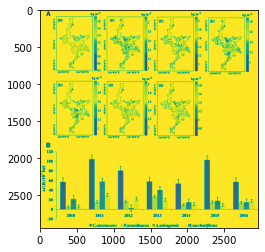

In [7]:
filename = "../data/raw/AGB/fpls-10-01281-g008.tif"

import xarray as xr
data = xr.open_rasterio(filename)
plt.imshow(data[0])

# Sweden NFI

In [7]:
df = pd.read_excel("../data/raw/AGB/NFI_Sweden/swe_nfi_plotdata.xls", sheet_name=1)
df

,Year,TractID,PlotID,Easting,Northing,PlotArea,LandUseClass,MeanHeight,StandAge,DwStem,...,NoStemsContorta,NoStemsSpruce,NoStemsBirch,NoStemsOtherDec,Soilmoisture_code,Soiltype_code,Soiltexture_code,Soildepth_code,Bottomlayertype_code,Fieldlayertype_code
0,2007,1001,106,669894,7116684,153.94,Skogsm,17.8,155,137734.865438,...,0.0,1494.088604,389.762245,0.000000,2,20,5,0.8,6,13
1,2007,1001,112,670490,7116694,153.94,Skogsm,2.2,21,2052.119905,...,0.0,1852.231948,0.000000,0.000000,4,11,6,0.8,5,11
2,2007,1001,118,671088,7116706,153.94,Myr,12.0,85,53137.363614,...,0.0,0.000000,3671.291239,0.000000,4,0,9,0.8,4,1
3,2007,1001,212,671110,7115502,153.94,Skogsm,0.2,2,0.000000,...,0.0,0.000000,0.000000,0.000000,3,20,5,0.8,6,9
4,2007,1001,218,671117,7114900,153.94,Skogsm,19.2,155,95494.860489,...,0.0,1494.189895,0.000000,64.960374,2,20,4,0.8,6,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31526,2019,5083,406,420106,6197126,153.94,Skogsm,20.5,33,125549.947367,...,0.0,1104.360123,64.960374,129.920748,2,20,6,0.8,6,9
31527,2019,5092,103,399609,6151861,153.94,Skogsm,24.1,41,126757.503242,...,0.0,519.716756,0.000000,64.960374,2,20,5,0.8,6,1
31528,2019,5092,406,399309,6151868,153.94,Skogsm,0.6,6,0.000000,...,0.0,0.000000,0.000000,0.000000,2,20,6,0.8,6,8
31529,2019,5093,103,378840,6151548,153.94,Skogsm,16.4,48,20353.952512,...,0.0,0.000000,0.000000,324.801871,3,12,5,0.8,6,1


In [ ]:
# Input: EPSG:3006 
# Output: 

In [31]:
from pyproj import Transformer

transformer = Transformer.from_crs("EPSG:3006", "EPSG:4326", authority="EPSG")

In [33]:
lat, lon = transformer.transform(df.iloc[0]["Northing"], df.iloc[0]["Easting"])

In [39]:
df["lat"], df["lon"] = transformer.transform(df["Northing"], df["Easting"])

In [40]:
df

,Year,TractID,PlotID,Easting,Northing,PlotArea,LandUseClass,MeanHeight,StandAge,DwStem,...,NoStemsBirch,NoStemsOtherDec,Soilmoisture_code,Soiltype_code,Soiltexture_code,Soildepth_code,Bottomlayertype_code,Fieldlayertype_code,lat,lon
0,2007,1001,106,669894,7116684,153.94,Skogsm,17.8,155,137734.865438,...,389.762245,0.000000,2,20,5,0.8,6,13,64.134697,18.491601
1,2007,1001,112,670490,7116694,153.94,Skogsm,2.2,21,2052.119905,...,0.000000,0.000000,4,11,6,0.8,5,11,64.134493,18.503833
2,2007,1001,118,671088,7116706,153.94,Myr,12.0,85,53137.363614,...,3671.291239,0.000000,4,0,9,0.8,4,1,64.134305,18.516109
3,2007,1001,212,671110,7115502,153.94,Skogsm,0.2,2,0.000000,...,0.000000,0.000000,3,20,5,0.8,6,9,64.123509,18.515195
4,2007,1001,218,671117,7114900,153.94,Skogsm,19.2,155,95494.860489,...,0.000000,64.960374,2,20,4,0.8,6,13,64.118114,18.514657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31526,2019,5083,406,420106,6197126,153.94,Skogsm,20.5,33,125549.947367,...,64.960374,129.920748,2,20,6,0.8,6,9,55.912920,13.721820
31527,2019,5092,103,399609,6151861,153.94,Skogsm,24.1,41,126757.503242,...,0.000000,64.960374,2,20,5,0.8,6,1,55.502517,13.410621
31528,2019,5092,406,399309,6151868,153.94,Skogsm,0.6,6,0.000000,...,0.000000,0.000000,2,20,6,0.8,6,8,55.502518,13.405871
31529,2019,5093,103,378840,6151548,153.94,Skogsm,16.4,48,20353.952512,...,0.000000,324.801871,3,12,5,0.8,6,1,55.494999,13.082134


In [68]:
import folium
from folium import plugins
f_map = folium.Map(location=[np.median(df["lat"]), np.median(df["lon"])], zoom_start=4.4)\
                   
# convert to (n, 2) nd-array format for heatmap
# points = df[['lat', 'lon']]

# # plot heatmap
# f_map.add_child(plugins.HeatMap(points, radius=7))

for point in df[["lat", "lon"]].values:
    folium.CircleMarker(list(point), fill_color="darkblue", radius=0.5, weight=0).add_to(f_map)
f_map.fit_bounds([[-90, -180], [90, 180]])
display(f_map)

# Other

In [4]:
filename = "../data/raw/AGB/CLIMAFRICA_Sampling_Plots/Congo_Sampling_Points.shp"
gdf = gpd.read_file(filename)
gdf

,CODE,X,Y,Type,Village,geometry
0,CO-KKO-02,174343,9483944,Biophysical,None,POINT (174343.000 9483944.000)
1,CO-KKO-03,175252,9476342,Biophysical,None,POINT (175252.000 9476342.000)
2,CO-KKO-04,171430,9471446,Biophysical,None,POINT (171430.000 9471446.000)
3,CO-KKO-05,170202,9470168,Biophysical,None,POINT (170202.000 9470168.000)
4,CO-KKO-06,174668,9474366,Biophysical,None,POINT (174668.000 9474366.000)
5,CO-KKO-07,173912,9476580,Biophysical,None,POINT (173912.000 9476580.000)
6,CO-KKO-08,176457,9477850,Biophysical,None,POINT (176457.000 9477850.000)
7,CO-KKO-00,164862,9469998,Biophysical,None,POINT (164861.818 9469997.705)
8,CO-KKO-01,166067,9466812,Biophysical,None,POINT (166066.854 9466812.066)
9,CO-TCH-00,124473,9522909,Biophysical,None,POINT (124472.859 9522909.452)


In [5]:
filename = "../data/raw/AGB/biomass/biomass.shp"
gdf = gpd.read_file(filename)
gdf

,OBJECTID,STATE,name_arabi,Shape_Leng,Shape_Area,Av_Vol_h,To_Vol,Av_AGB_t_h,Tot_AGB_t,geometry
0,18.0,Al Gezira,Ø§ÙØ¬Ø²ÙØ±Ø©,8.787811,27229.194796,0.000000,NaN,NaN,NaN,"POLYGON ((33.56922 15.45538, 33.57492 15.43839..."
1,1.0,Blue Nile,Ø§ÙÙÙÙ Ø§ÙØ§Ø²,8.844899,38150.326423,7.122431,1.856574e+07,5.212932,1.358833e+07,"POLYGON ((35.05032 11.74069, 35.05232 11.73329..."
2,6.0,Khartoum,Ø§ÙØ®Ø±Ø·ÙÙ,7.404397,21206.776142,0.254944,1.542380e+06,0.250999,1.518511e+06,"POLYGON ((33.43582 16.11349, 33.51042 16.05459..."
3,11.0,River Nile,ÙÙØ± Ø§ÙÙÙÙ,17.850992,129627.563602,0.074450,3.429059e+05,0.054533,2.511678e+05,"POLYGON ((33.55376 21.72248, 33.54533 21.72142..."
4,7.0,Northern,Ø§ÙØ´Ù Ø§ÙÙØ©,26.188226,365484.400368,2.186194,1.546313e+06,1.539044,1.088579e+06,"POLYGON ((32.41512 21.93739, 32.39432 21.30599..."
5,9.0,North Kordofan,Ø´Ù Ø§Ù ÙØ±Ø¯ÙØ§,19.179364,187649.513122,0.957305,1.444344e+07,0.843617,1.272816e+07,"POLYGON ((29.78812 12.74259, 29.78819 12.74765..."
6,12.0,Sennar,Ø³ÙØ§Ø±,12.368708,39355.888610,3.969588,9.141753e+06,3.727829,8.584995e+06,"POLYGON ((33.85962 14.03019, 33.92652 14.00589..."
7,14.0,South Kordofan,Ø¬ÙÙØ¨ ÙØ±Ø¯ÙØ§,11.197204,78460.994599,9.577795,4.169210e+07,7.623777,3.318627e+07,"POLYGON ((29.94703 10.29220, 29.94430 10.29716..."
8,17.0,White Nile,Ø§ÙÙÙÙ Ø§ÙØ§Ø¨,10.487477,37956.462026,0.024784,1.054921e+05,0.022534,9.591516e+04,"POLYGON ((32.54870 15.20120, 32.54050 15.17870..."
9,5.0,Kassala,ÙØ³ÙØ§,11.347523,51369.646919,0.048747,1.370527e+05,0.048338,1.359030e+05,"POLYGON ((36.64436 17.00747, 36.75853 17.00274..."


In [6]:
filename = "../data/raw/AGB/sugarcane_data/GIS Layers/Fields.shp"
gdf = gpd.read_file(filename)
gdf

,Field name,Variety,Ratoon,Harvesting,Area [ha],Perim. [m],geometry
0,F3,SP80-3280,2nd cycle,August,25,2004,"POLYGON ((-47.52470 -22.87121, -47.52469 -22.8..."
1,F2,SP80-3280,1st cycle,October,115,6030,"POLYGON ((-47.42327 -22.85055, -47.42327 -22.8..."
2,F1,RB867515,1st cycle,October,58,8342,"POLYGON ((-47.45328 -22.97049, -47.45328 -22.9..."
3,F4,SP80-3280,9th cycle,August,59,3921,"POLYGON ((-47.50940 -22.89051, -47.50940 -22.8..."
